# Cell Type Verification
Sepp data already contains cell type labels based on typical clustering and annotation strategies, coupled with some extra information from accompanying spatial data, e.g. FISH, and morphological data (mostly used for subtyping of cells expressing non-canonical markers). It is unlikely that we will be able to annotate these cells any more accurately than this with just the expression data, so instead we will verify these cell typings using known marker genes taken from literature to make sure expression patterns generally conform to what we expect to see and help tease out temporal patterns in the UMAPs.

In [1]:
import anndata as ad
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from matplotlib.pyplot import rc_context
import math
FIG_PATH = '/group/ll005/cmcphan/notebooks/analysis/results/figures/'

sc.settings.verbosity = 0 # Show errors, ignore warnings - mostly to avoid complaints about palette being too small

In [2]:
adata_list = []
adata_list.append(ad.read_h5ad('/group/ll005/cmcphan/herring_data/Processed_data_RNA-all_full-counts-and-downsampled-CPM.h5ad'))
adata_list.append(ad.read_h5ad('/group/ll005/cmcphan/sepp_data/sepp_human_normal_reduced.h5ad'))
adata_list.append(ad.read_h5ad('/group/ll005/cmcphan/sepp_data/sepp_mouse_normal_reduced.h5ad'))
adata_list.append(ad.read_h5ad('/group/ll005/cmcphan/sepp_data/sepp_opossum_normal_reduced.h5ad'))

[Harmony](https://www.nature.com/articles/s41592-019-0619-0) is a batch correction tool which aims to integrate datasets by optimizing 2 objective measures of data mixing and cell type separation. We will apply this algorithm to try to mitigate batch effects and make the UMAP clearer for cell type groupings.

In [3]:
for adata in adata_list[1:]:
    sc.external.pp.harmony_integrate(adata, key='batch')

2025-05-20 15:09:20,443 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-20 15:09:44,904 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-20 15:09:46,298 - harmonypy - INFO - Iteration 1 of 10
2025-05-20 15:10:47,598 - harmonypy - INFO - Iteration 2 of 10
2025-05-20 15:11:46,749 - harmonypy - INFO - Converged after 2 iterations
2025-05-20 15:11:46,830 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-20 15:12:00,154 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-20 15:12:00,628 - harmonypy - INFO - Iteration 1 of 10
2025-05-20 15:12:28,483 - harmonypy - INFO - Iteration 2 of 10
2025-05-20 15:12:51,269 - harmonypy - INFO - Iteration 3 of 10
2025-05-20 15:13:18,755 - harmonypy - INFO - Iteration 4 of 10
2025-05-20 15:13:42,873 - harmonypy - INFO - Converged after 4 iterations
2025-05-20 15:13:42,928 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-20 15:13

In [4]:
for adata in adata_list[1:]:
    sc.pp.neighbors(adata, use_rep='X_pca_harmony')
    sc.tl.umap(adata)

/home/cmcphan/.conda/envs/anndata/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


We will begin with the mouse data since this is the best understood and annotations were lifted over from mouse to the other datasets.

In [5]:
# MOUSE
adata_list[2]

AnnData object with n_obs × n_vars = 60028 × 20424
    obs: 'orig_cluster', 'orig_sub_cluster', 'broad_lineage', 'cell_type', 'dev_state', 'subtype', 'precisest_label', 'species', 'Tissue', 'TissueID', 'batch', 'Capture.System', 'UMAP1', 'UMAP2', 'Stage', 'stage.ord', 'size_factor', 'sex', 'age', 'fragment', 'rqn_cytoplasm', 'nuclei_preparation', 'chromium_version', 'numerical_age', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'log10_gene_counts', 'log10_UMI_counts', 'percent_mito'
    var: 'ensembl_gene_id', 'gene_symbol', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'batch_colors', 'batch_colors_dict', 'batch_order', 'cell_type_colors', 'chromium_version_colors', 'fragment_colors', 'hvg', 'neighbors', 'nuclei_preparation_colors', 'pca', 'sex_colors', 'umap'
    obsm: 'X

In [6]:
for e in pd.unique(adata_list[2].obs['cell_type'].values):
    print(e)

interneuron
parabrachial
MBO
astroglia
Purkinje
GABA_DN
isth_N
glut_DN
VZ_neuroblast
GC
nan
NTZ_mixed
erythroid
GC/UBC
noradrenergic
NTZ_neuroblast
immune
oligo
mural/endoth
meningeal
UBC
ependymal
neural_crest_progenitor


For the most part we're only really interested in the major cerebellar cell types - the Sepp paper mentions that some of the less common cell types were not detected in certain batches. As such the others may be in such small populations that they won't be as useful for analysis, or won't exist across batches and therefore won't be useful in looking for developmental changes.

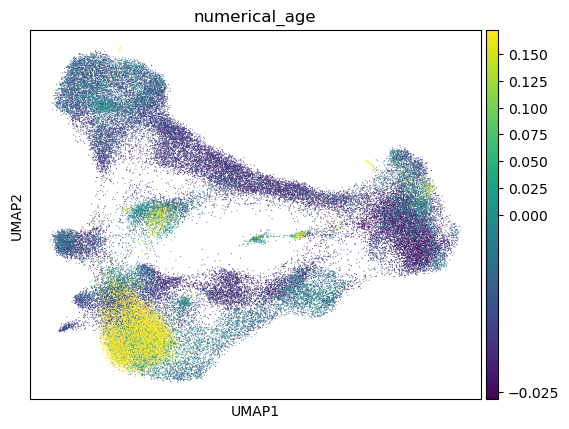

In [7]:
# MOUSE
# Map of developmental age, for comparison
sc.pl.umap(adata_list[2], layer='binarized_cts', color='numerical_age', vcenter=0)

In [8]:
# Add all major cell types with their marker genes into a dictionary for checking
# Note that for mouse and opossum genes, only the first letter of the symbol is capitalized
markers_gene_symbol = {'Purkinje':['Calb1', 'Skor2', 'Ppp1r17', 'Ip3r', 'Klhl1', 'Rora', 'Ca8', 'Itpr1', 'Dab1'], # Gene symbols
                       'interneuron':['Pax2', 'Klhl1', 'Lypd6', 'Prkcd'],
                       'VZ_neuroblast':['Ptf1a', 'Lhx1', 'Lhx5', 'Corl2', 'Neph3', 'Cdh1'], # General VZ progenitor markers
                       'UBC':['Tbr2', 'Eomes', 'Calb2', 'Grm1', 'Lmx1a', 'Mki67', 'Otx2'],
                       'GC':['Gabra6', 'Reln', 'Rbfox3', 'Atoh1', 'Mycn', 'Neurod1'],
                       'NTZ_neuroblast':['Atoh1', 'Lmx1a', 'Zic1', 'Zic3', 'Meis1', 'Pax6', 'Pde1c'], # General RL progenitor markers
                       'astroglia':['Aqp4', 'C1qa', 'Gdf10', 'Slc1a3', 'Pax6', 'Sox2', 'Hes1', 'Hes5', 'Cdh2', 'Pdgfd', 'Tubb2b', 'Tuba1a'],
                       'oligo':['Mobp', 'Olig2', 'Pdgfra', 'Mbp', 'Sox10', 'Mag', 'Mog']}

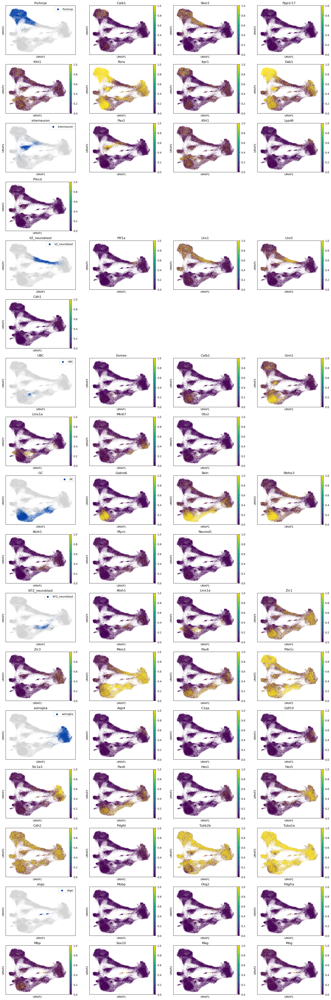

In [9]:
# MOUSE
adata = adata_list[2]
# Dictionary of cell types which will hold each related set of marker genes
# in a nested dictionary, so that we have gene symbols linked to var_names
markers = {}
# UMAP function can only take var_names as input for colour, not gene_symbols, so need to convert
for cell_type in markers_gene_symbol.keys():
    markers[cell_type] = {}
    for marker in markers_gene_symbol[cell_type]:
        name = adata.var_names[adata.var['gene_symbol'] == marker].values
        if name.size>0: # If the marker isn't present in the dataset, ignore it
            markers[cell_type][name[0]] = marker

nrows = 0 
# Calculate how many rows we will need
for cell_type in markers:
    nrows += math.ceil((len(markers[cell_type])+1)/4)
ncols = 4
wspace = 0.5
figsize = 4
fig, axs = plt.subplots(nrows = nrows, ncols = ncols, 
                        figsize=(ncols * figsize + figsize * wspace * (ncols-1), nrows * figsize))
ax_idx_row = 0
for cell_type in markers.keys():
    # First plot in block is just the cell type
    sc.pl.umap(adata, layer='binarized_cts', color='cell_type', gene_symbols='gene_symbol', groups=cell_type,
               na_in_legend=False, legend_loc='upper right', ax=axs[ax_idx_row,0], palette=['#023fa5'], title=cell_type, show=False)
    # Build remaining plots based on relevant marker genes
    ax_idx_col = 1
    for marker in markers[cell_type].keys():
        sc.pl.umap(adata, layer='binarized_cts', color=marker, gene_symbols='gene_symbol',
                   na_in_legend=False, legend_loc='upper right', ax=axs[ax_idx_row, ax_idx_col], 
                   title=markers[cell_type][marker], show=False)
        ax_idx_col+=1
        if ax_idx_col == ncols: # Wrap to next row
            ax_idx_col=0
            ax_idx_row+=1
    while ax_idx_col < ncols and ax_idx_col > 0: # Once markers are exhausted, remove unused plots in row
        axs[ax_idx_row, ax_idx_col].remove()
        ax_idx_col+=1
        if ax_idx_col == ncols:
            ax_idx_row+=1 # Move to next row for the next cell type

#### Purkinje cells
Should be by far the most abundant cell type early in development, with markers CALB1 increasing over time and SKOR2 decreasing over time.\
\
Markers match up pretty well - CALB1 is expected to increase over time and shows strong expression in the Purkinje clusters corresponding to later time periods, SKOR2 seems to be generally expressed in Purkinje clusters, though there is some expression in the string of cells radiating up from the second main cluster. SKOR2 is also involved more generally in cerebellar morphogenesis (see GO terms on any gene database), so is likely present in other cells as well. Klhl1 is a less specific marker and is weakly expressed in Purkinje cells - it should be expressed more highly in Purkinje layer interneurons. Others are present in other cells of the ventricular zone (RORA), or are non-canonical markers flagged as differentially expressed in the Aldinger paper and aren't necessarily highly specific to Purkinje cells.

#### Interneurons
Should appear at around the same time as Purkinje cells early in development. All should express PAX2, Klhl1 expressed by Purkinje layer INs, Lypd6 and Prkcd by molecular layer INs.\
\
Cell typing matches very well with the main marker PAX2. Klhl1 also seems to match, though this is less clear due to the wider range of cells expressing this marker. Lypd6 and Prkcd match up less closely, but expression is overall low for these markers. The small, rightmost cluster of interneurons is less convincing than the rest, not expressing PAX2, however these do seem to express the other markers, so could well be interneurons. Good to keep these in mind for the other labels to see if something else might match up better.

#### Unipolar brush cells
Should appear the latest of the major cerebellar cell types, at around E16.5. Main canonical markers are TBR2/EOMES. Distinct canonical subtypes expressing Calb2, Grm1, or both. LMX1A, MKI67 and OTX2 are more general RL neuron markers which should be expressed by earlier UBCs, as expression of these declines over development.\
\
TBR2/EOMES are the main canonical markers and refer to the same gene - in this dataset it is labelled as Eomes. UBCs seem to represent a fairly small portion of the overall nuclei and match reasonably well with Eomes expression. Calb2 and Grm1 seem to be much less specific but do also show overlap with Eomes expression and the UBC label. The smaller clusters marked as UBCs are much less convincing, and seem to be largely absent of relevant marker expression, except perhaps Grm1. 

#### Astroglia
As per the Sepp paper, this seems to include a variety of distinct cell types, as 'astroglia' is a collective term. Along with known glial cell types such as astrocytes, microglia and Bergmann glia, they also seem to have included the elusive 'glioblast', as well as 'neural progenitors with temporally progressing cell states'. The latter is another odd inclusion as these would seem to fit different categories much better and would tend not to give rise to the typical glial cells. Oligodendrocytes seem to be distinct, even though astrocytes are included and these differentiate from the glioblasts which are also part of the group. All in all, a wider net of marker genes needs to be cast here, unless we'd prefer to split this group into some of the more specific subtypings.

In [10]:
np.unique(adata_list[2].obs['precisest_label'][adata_list[2].obs['cell_type'] == 'astroglia'].values)

array(['astro_Bergmann', 'astro_parenh', 'astroblast', 'glioblast_PWM',
       'progenitor', 'progenitor_Nckap5_neg', 'progenitor_RL',
       'progenitor_RL_early', 'progenitor_RP', 'progenitor_VZ_early',
       'progenitor_VZ_posterior', 'progenitor_bipotent',
       'progenitor_gliogenic', 'progenitor_isthmic'], dtype=object)

This confirms that several different progenitor populations are also included in the 'astroglia' category, which makes the overlap with marker genes less precise. 

In [11]:
just_astros_mk = adata_list[2][adata_list[2].obs['cell_type'] == 'astroglia'].obs['precisest_label'].isin(['astro_Bergmann', 'astro_parenh', 'astroblast', 'glioblast_PWM'])
just_astros = adata_list[2][adata_list[2].obs['cell_type'] == 'astroglia'][just_astros_mk]
just_astros

View of AnnData object with n_obs × n_vars = 786 × 20424
    obs: 'orig_cluster', 'orig_sub_cluster', 'broad_lineage', 'cell_type', 'dev_state', 'subtype', 'precisest_label', 'species', 'Tissue', 'TissueID', 'batch', 'Capture.System', 'UMAP1', 'UMAP2', 'Stage', 'stage.ord', 'size_factor', 'sex', 'age', 'fragment', 'rqn_cytoplasm', 'nuclei_preparation', 'chromium_version', 'numerical_age', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'log10_gene_counts', 'log10_UMI_counts', 'percent_mito'
    var: 'ensembl_gene_id', 'gene_symbol', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'batch_colors', 'batch_colors_dict', 'batch_order', 'cell_type_colors', 'chromium_version_colors', 'fragment_colors', 'hvg', 'neighbors', 'nuclei_preparation_colors', 'pca', 'sex_colors', 'umap'
    ob

Actual astroglia (excluding oligodendrocytes) make up only a very small portion of total cells - 786/60028

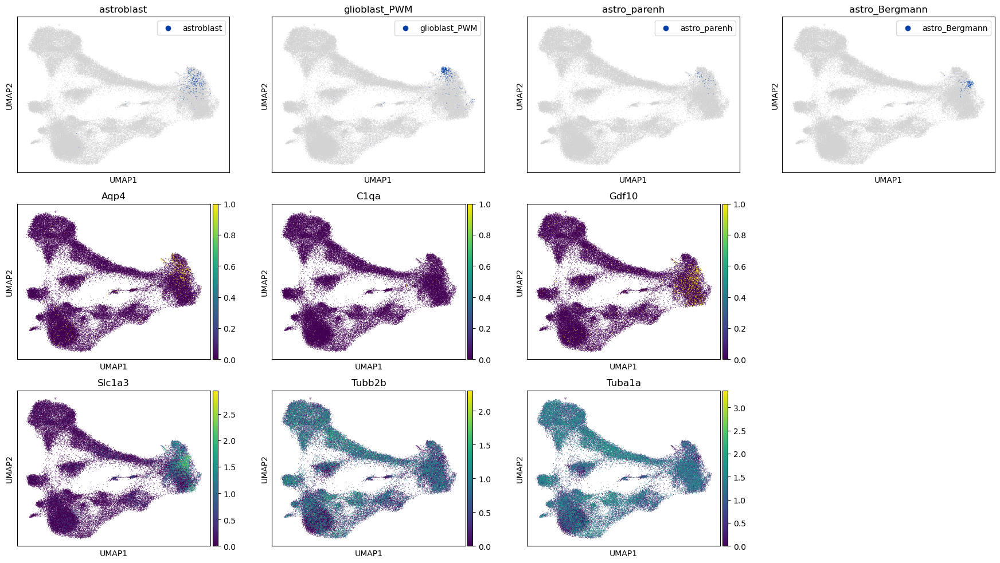

In [12]:
nrows = 3
ncols = 4
wspace = 0.5
figsize = 4
fig, axs = plt.subplots(nrows = nrows, ncols = ncols, 
                        figsize=(ncols * figsize + figsize * wspace * (ncols-1), nrows * figsize))
ax_idx_col = 0
for cell_type in pd.unique(just_astros.obs['precisest_label']):
    sc.pl.umap(adata_list[2], layer='binarized_cts', color='precisest_label', gene_symbols='gene_symbol', groups=cell_type,
               na_in_legend=False, legend_loc='upper right', ax=axs[0,ax_idx_col], palette=['#023fa5'], title=cell_type, show=False)
    ax_idx_col+=1
ax_idx_col = 0
for marker in ['ENSMUSG00000024411', 'ENSMUSG00000036887', 'ENSMUSG00000021943']: # Aqp4, C1qa, Gdf10
    sc.pl.umap(adata_list[2], layer='binarized_cts', color=marker, gene_symbols='gene_symbol',
                   na_in_legend=False, legend_loc='upper right', ax=axs[1, ax_idx_col], 
                   title=markers['astroglia'][marker], show=False)
    ax_idx_col+=1
axs[1,3].remove()
ax_idx_col = 0
for marker in ['ENSMUSG00000005360', 'ENSMUSG00000045136', 'ENSMUSG00000072235']: # Slc1a3, Tubb2b, Tuba1a
    # These are computed markers with greater effect sizes reported in glioblasts, according
    # to CELLxGENE - effect size of Slc1a3 = 1.05, Tubb2b = 2.55, Tuba1a = 2.01; use downsampled normalized counts to look for
    # clusters with higher expression magnitude
    sc.pl.umap(adata_list[2], layer='ds_norm_cts', color=marker, gene_symbols='gene_symbol',
                   na_in_legend=False, legend_loc='upper right', ax=axs[2, ax_idx_col], 
                   title=markers['astroglia'][marker], show=False)
    ax_idx_col+=1
axs[2,3].remove()

Astrocyte/astroblast clusters match well with the marker Aqp4, which also has weak expression in Bergmann glia. The microglia marker C1qa is almost absent from the dataset, and there is no specific microglia label given. Markers Gdf10 and Aqp4 overlap well in the Bergmann glia cluster as expected, though there is also overlap in the lower astroblast cluster. The glioblast designation is more elusive, with Slc1a3 being described as the marker used for labelling in the Sepp paper, however expression is fairly widespread and the strongest expression appears to be outside of the glioblast clusters. A similar pattern is observed in the other computational markers, suggesting that this label should be treated with much lower confidence. These discrepancies are noted, however their impact is expected to be very low for this analysis, since these represent extremely small populations and are unlikely to grant any key insights into broad expression patterns across development, especially since all of the astroglial populations appear to be present over a relatively narrow time period in this data.

#### Oligodendrocytes
Pretty small population present, marker genes partially match up. Canonical markers Mobp and Olig2 are only expressed in what looks like one half of the upper labelled cluster. Pdgfra is an oligodendrocyte precursor marker, should be absent in mature oligodendrocytes, and seems to match with the remaining clusters, suggesting that perhaps some of the cells labelled as oligodendrocytes are actually precursors and not mature cells.

In [13]:
np.unique(adata_list[2].obs['precisest_label'][adata_list[2].obs['cell_type'] == 'oligo'].values)

array(['COP', 'OPC', 'oligodendrocyte'], dtype=object)

This confirms that indeed precursor cells (OPCs) are also included in this group. Marker genes match up well in this case.

#### NTZ/VZ Neuroblasts
From the Sepp paper, these are not true cell states, instead being clusters within which a variety of cell types begin their progression, labelled based on their relation to other clusters instead of on their expression of a specific set of marker genes. They do show good overlap with some markers considered canonical for either RL or VZ progenitor cells, for example Atoh1 in the RL/NTZ lineage and Lhx1, Lhx5 for the Purkinje cell lineage, with the latter showing expression in the differentiated Purkinje clusters as well. These labels should be fine, as it should be sufficient to treat these as simply immature cells of a particular lineage.

Overall, existing cell type designations for the mouse dataset appear to be sufficient for our purposes, based on how well they match to cell markers taken from literature and how the clusters organize based on the expected patterns of development relative to sample age. In general we will use the coarser cell typings and refrain from making reference to specific subtypes, however broader designations e.g. mature vs immature cells for RL/VZ/oligodendrocyte lineages may prove useful. For RL/VZ lineages, immature cells are in the NTZ/VZ neuroblast groups, while for OPCs, we can use the precise label. Some of the much less common cell types, for example specific flavours of astroglial cells, should be treated with less confidence, however these are unlikely to be particularly impactful for our analysis. The use of coarser typings is especially relevant since there is evidence for complex specialisations in some cell types, especially human Purkinje cells (see [Kozareva et al. 2019](https://www.nature.com/articles/s41586-021-03220-z)) which would be infeasible to accurately define and may not be conserved across species. Handling these differences is outside the scope of this study, hence precise subtypings will be largely ignored in favour of more general labels.

# Human and Opossum Data
Cerebellum development is well conserved across mammalian species, though timings and cell type ratios are different and the human cerebellum has an expanded ventricular zone which includes a sub-ventricular zone. Molecular markers have also been shown to be consistent across species, so we will use the same marker genes for all 3 datasets, looking for the orthologous genes. See [Aldinger et al. 2021](https://www.nature.com/articles/s41593-021-00872-y), [Haldipur et al. 2019](https://pmc.ncbi.nlm.nih.gov/articles/PMC6897295/), [Leto et al. 2016](https://pubmed.ncbi.nlm.nih.gov/26439486/), [Kozareva et al. 2021](https://www.nature.com/articles/s41586-021-03220-z). 

In [14]:
# HUMAN
adata_list[1]

AnnData object with n_obs × n_vars = 157202 × 27260
    obs: 'orig_cluster', 'orig_sub_cluster', 'broad_lineage', 'cell_type', 'dev_state', 'subtype', 'precisest_label', 'species', 'Tissue', 'TissueID', 'batch', 'Capture.System', 'UMAP1', 'UMAP2', 'Stage', 'stage.ord', 'Stage_exact', 'size_factor', 'sex', 'age', 'fragment', 'rqn_cytoplasm', 'nuclei_preparation', 'chromium_version', 'numerical_age', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'log10_gene_counts', 'log10_UMI_counts', 'percent_mito'
    var: 'ensembl_gene_id', 'gene_symbol', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'Tissue_colors', 'batch_colors', 'batch_colors_dict', 'batch_order', 'broad_lineage_colors', 'cell_type_colors', 'chromium_version_colors', 'fragment_colors', 'hvg', 'neighbors', 'nuclei_prep

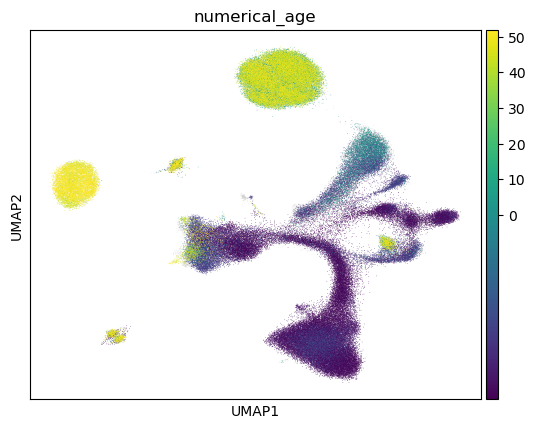

In [15]:
# HUMAN
# Map of developmental age, for comparison
sc.pl.umap(adata_list[1], layer='binarized_cts', color='numerical_age', vcenter=0)

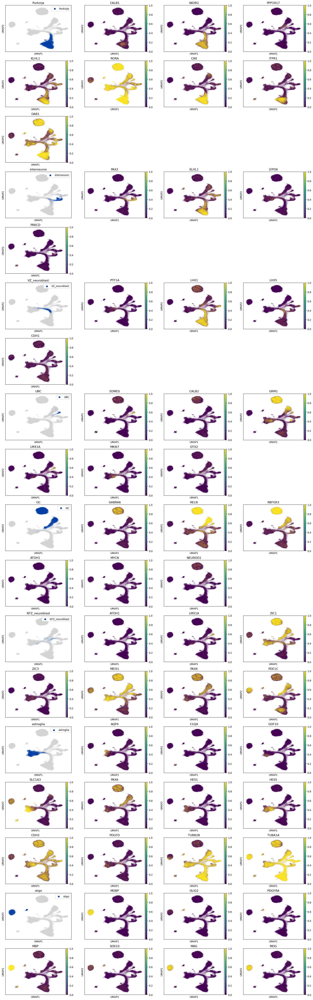

In [16]:
# HUMAN
adata = adata_list[1]
# Dictionary of cell types which will hold each related set of marker genes
# in a nested dictionary, so that we have gene symbols linked to var_names
markers = {}
# UMAP function can only take var_names as input for colour, not gene_symbols, so need to convert
for cell_type in markers_gene_symbol.keys():
    markers[cell_type] = {}
    for marker in markers_gene_symbol[cell_type]:
        marker = marker.upper() # Human gene symbols need to be fully capitalized
        name = adata.var_names[adata.var['gene_symbol'] == marker].values
        if name.size>0: # If the marker isn't present in the dataset, ignore it
            markers[cell_type][name[0]] = marker

nrows = 0 
# Calculate how many rows we will need
for cell_type in markers:
    nrows += math.ceil((len(markers[cell_type])+1)/4)
ncols = 4
wspace = 0.5
figsize = 4
fig, axs = plt.subplots(nrows = nrows, ncols = ncols, 
                        figsize=(ncols * figsize + figsize * wspace * (ncols-1), nrows * figsize))
ax_idx_row = 0
for cell_type in markers.keys():
    # First plot in block is just the cell type
    sc.pl.umap(adata, layer='binarized_cts', color='cell_type', gene_symbols='gene_symbol', groups=cell_type,
               na_in_legend=False, legend_loc='upper right', ax=axs[ax_idx_row,0], palette=['#023fa5'], title=cell_type, show=False)
    # Build remaining plots based on relevant marker genes
    ax_idx_col = 1
    for marker in markers[cell_type].keys():
        sc.pl.umap(adata, layer='binarized_cts', color=marker, gene_symbols='gene_symbol',
                   na_in_legend=False, legend_loc='upper right', ax=axs[ax_idx_row, ax_idx_col], 
                   title=markers[cell_type][marker], show=False)
        ax_idx_col+=1
        if ax_idx_col == ncols: # Wrap to next row
            ax_idx_col=0
            ax_idx_row+=1
    while ax_idx_col < ncols and ax_idx_col > 0: # Once markers are exhausted, remove unused plots in row
        axs[ax_idx_row, ax_idx_col].remove()
        ax_idx_col+=1
        if ax_idx_col == ncols:
            ax_idx_row+=1 # Move to next row for the next cell type

In general major markers match up very well. Expected developmental patterns seem to be recapitulated, with Purkinje cells dominating early on and declining as development progresses, with granule cells overtaking with time. Cell type ratios do appear quite different to the mouse dataset, especially for some of the smaller populations like oligodendrocytes, which seem to have a much more defined cluster in the human data, and true astrocytes. These may be reflective of differences in sampling or library size, as the human data retained many more cells through QC. There also appear to be a lower proportion of neuroblasts of both major lineages, possibly for similar reasons. Regardless, differences in cell type ratios are expected and coarse marker expression suggests we can be confident in major cell type labels. 

In [17]:
# OPOSSUM
adata_list[3]

AnnData object with n_obs × n_vars = 88433 × 28773
    obs: 'orig_cluster', 'orig_sub_cluster', 'broad_lineage', 'cell_type', 'dev_state', 'subtype', 'precisest_label', 'species', 'Tissue', 'TissueID', 'batch', 'Capture.System', 'UMAP1', 'UMAP2', 'Stage', 'stage.ord', 'size_factor', 'sex', 'age', 'fragment', 'rqn_cytoplasm', 'nuclei_preparation', 'chromium_version', 'numerical_age', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'log10_gene_counts', 'log10_UMI_counts', 'percent_mito'
    var: 'ensembl_gene_id', 'gene_symbol', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'batch_colors', 'batch_colors_dict', 'batch_order', 'cell_type_colors', 'fragment_colors', 'hvg', 'neighbors', 'nuclei_preparation_colors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap', 'X_pca_harmony'
    varm

Some major markers are absent from the dataset based on gene symbol, manually checked for orthologues via Ensembl and added in below if present

In [18]:
missing_markers = {'EOMES':'ENSMODG00000015057',
                   'MOBP':'ENSMODG00000011047',
                   'ATOH1':'ENSMODG00000019270',
                   'LHX1':'ENSMODG00000037875',
                   'LHX5':'ENSMODG00000027538'}
for gene in missing_markers:
    marker = missing_markers[gene]
    print(adata_list[3].var_names[adata_list[3].var_names == marker])

Index(['ENSMODG00000015057'], dtype='object')
Index(['ENSMODG00000011047'], dtype='object')
Index([], dtype='object')
Index([], dtype='object')
Index(['ENSMODG00000027538'], dtype='object')


As per manual check for orthologues, ATOH1 and LHX1 are missing from the opossum data

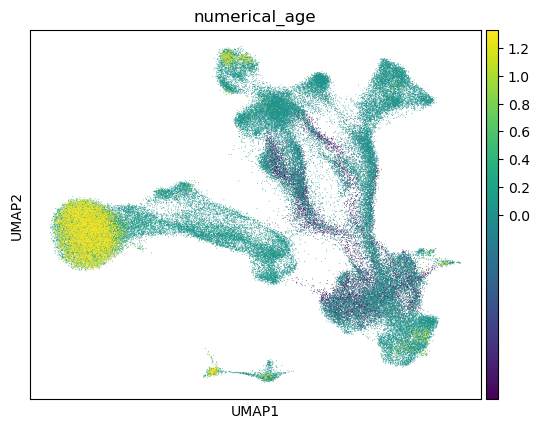

In [19]:
# OPOSSUM
# Map of developmental age, for comparison
sc.pl.umap(adata_list[3], layer='binarized_cts', color='numerical_age', vcenter=0)

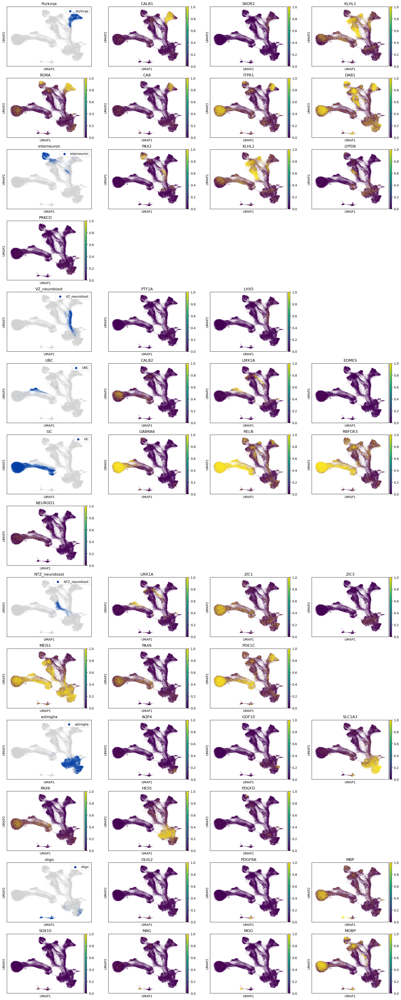

In [20]:
# OPOSSUM
adata = adata_list[3]
# Dictionary of cell types which will hold each related set of marker genes
# in a nested dictionary, so that we have gene symbols linked to var_names
markers = {}
# UMAP function can only take var_names as input for colour, not gene_symbols, so need to convert
for cell_type in markers_gene_symbol.keys():
    markers[cell_type] = {}
    for marker in markers_gene_symbol[cell_type]:
        marker = marker.upper() # Opossum gene symbols are borrowed from humans, need to be fully capitalized
        name = adata.var_names[adata.var['gene_symbol'] == marker].values
        if name.size>0: # If the marker isn't present in the dataset, ignore it
            markers[cell_type][name[0]] = marker
# Some major markers are missing from the Opossum data, manually checked for orthologues via Ensembl and added in if present (see above)
markers['UBC']['ENSMODG00000015057']='EOMES'
markers['oligo']['ENSMODG00000011047']='MOBP'
markers['VZ_neuroblast']['ENSMODG00000027538']='LHX5'

nrows = 0 
# Calculate how many rows we will need
for cell_type in markers:
    nrows += math.ceil((len(markers[cell_type])+1)/4)
ncols = 4
wspace = 0.5
figsize = 4
fig, axs = plt.subplots(nrows = nrows, ncols = ncols, 
                        figsize=(ncols * figsize + figsize * wspace * (ncols-1), nrows * figsize))
ax_idx_row = 0
for cell_type in markers.keys():
    # First plot in block is just the cell type
    sc.pl.umap(adata, layer='binarized_cts', color='cell_type', gene_symbols='gene_symbol', groups=cell_type,
               na_in_legend=False, legend_loc='upper right', ax=axs[ax_idx_row,0], palette=['#023fa5'], title=cell_type, show=False)
    # Build remaining plots based on relevant marker genes
    ax_idx_col = 1
    for marker in markers[cell_type].keys():
        sc.pl.umap(adata, layer='binarized_cts', color=marker, gene_symbols='gene_symbol',
                   na_in_legend=False, legend_loc='upper right', ax=axs[ax_idx_row, ax_idx_col], 
                   title=markers[cell_type][marker], show=False)
        ax_idx_col+=1
        if ax_idx_col == ncols: # Wrap to next row
            ax_idx_col=0
            ax_idx_row+=1
    while ax_idx_col < ncols and ax_idx_col > 0: # Once markers are exhausted, remove unused plots in row
        axs[ax_idx_row, ax_idx_col].remove()
        ax_idx_col+=1
        if ax_idx_col == ncols:
            ax_idx_row+=1 # Move to next row for the next cell type

Marker gene expression for the opossum cells is much less clear in comparison to the other species. Purkinje cells show good overlap with the main marker CALB1, however much less so with SKOR2, which showed strong expression in the other species. Interneurons show a partial overlap with main marker PAX2, however there are several clusters here which do not match up with any of the other markers used. UBCs lack the main marker EOMES, which is almost absent in this dataset, but show good overlap with LMX1A, though this marker is less specific. Granule cells are the most clear, with strong expression of several main markers in well circumscribed clusters. Astroglia appear much more abundant here than in the other species, showing clusters that overlap with several of the known markers for different glial subtypes. Once again it appears that SLC1A3 was the main marker used for typing here, with the majority of cells corresponding to strong SCL1A3 expression, though the veracity of this typing remains dubious. Oligodendrocytes show limited expression of OLIG2, with stronger expression of PGDFRA, suggesting that there are a greater proportion of OPCs in this dataset. The MOBP orthologue, which is not a strong match to human MOBP, shows much wider expression than in the other species, extending into the granule cell and interneuron clusters, but does show some expression in the oligodendrocyte group. NTZ/VZ neuroblast groups are much less clear here, showing weak expression of the general progenitor markers. Overall, the opossum typing seems much less reliable and should be treated with much less confidence. This could be due to a number of factors, however a major possibility is simply the lower coverage annotation of the genome and less well defined orthologues, along with the greater genomic distance relative to human/mouse.

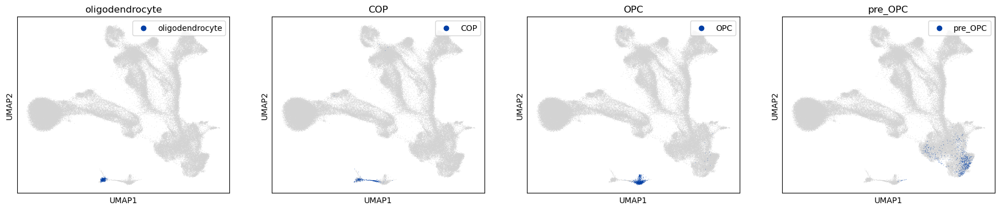

In [21]:
just_oligos = adata_list[3][adata_list[3].obs['cell_type'] == 'oligo']

nrows = 1
ncols = 4
wspace = 0.5
figsize = 4
fig, axs = plt.subplots(nrows = nrows, ncols = ncols, 
                        figsize=(ncols * figsize + figsize * wspace * (ncols-1), nrows * figsize))
ax_idx_col = 0
for cell_type in pd.unique(just_oligos.obs['precisest_label']):
    sc.pl.umap(adata_list[3], layer='binarized_cts', color='precisest_label', gene_symbols='gene_symbol', groups=cell_type,
               na_in_legend=False, legend_loc='upper right', ax=axs[ax_idx_col], palette=['#023fa5'], title=cell_type, show=False)
    ax_idx_col+=1

Cannot verify the pre_OPC label - not expressing PDGFRA, only seem to express the much less specific myelin associated markers

In [22]:
# Save harmonized versions of data
adata_list[1].write_h5ad('/group/ll005/cmcphan/sepp_data/sepp_human_normal_reduced.h5ad')
adata_list[2].write_h5ad('/group/ll005/cmcphan/sepp_data/sepp_mouse_normal_reduced.h5ad')
adata_list[3].write_h5ad('/group/ll005/cmcphan/sepp_data/sepp_opossum_normal_reduced.h5ad')

---
## Trajectories
As part of verifying cell type identities, we want to make sure that patterns of development follow what we'd expect for each type - that cells are appearing at the right times, are feeding into the correct populations, and to make sure that there aren't more advanced labels that would better suit each group. We're also interested in looking at how cell type proportions change over development, and particularly whether populations persist across time periods. Any that don't could pose problems for analysis later, where we will be looking at how expression changes between time periods.

In [23]:
adata_list[0] = ad.read_h5ad('/group/ll005/cmcphan/herring_data/Processed_data_RNA-all_full-counts-and-downsampled-CPM.h5ad')

In [24]:
adata_list[0].obs[['stage_id', 'age', 'numerical_age']].drop_duplicates().sort_values(by='numerical_age')

,stage_id,age,numerical_age
AAACCCAAGAGTCTTC-RL2103_ga22_v3,Fetal,ga22,-0.345205
AAACCCAAGATACAGT-RL2107_ga24_v3,Fetal,ga24,-0.306849
AAACCCAAGGTAGACC-RL2121_ga34_v3,Fetal,ga34,-0.115068
AAACCCAAGTACAACA-RL1777_2d_v3,Neonatal,2d,0.005479
AAACCTGAGAGTCGGT-RL1612_34d_v2,Neonatal,34d,0.093151
AAACCCAAGAGGCCAT-RL2100_86d_v3,Infancy,86d,0.235616
AAACCCAAGGCCACCT-RL2104_118d_v3,Infancy,118d,0.323288
AAACCCAAGCAGGCAT-RL2108_179d_v3,Infancy,179d,0.490411
AAACCCAAGTCACTGT-RL2122_301d_v3,Infancy,301d,0.824658
AAACCCAAGCCTGAGA-RL2125_422d_v3,Childhood,422d,1.156164


Change stage labels in Sepp human data to match up with those from the Herring data.

In [8]:
stages = []
for age in adata_list[1].obs['numerical_age'].values:
    if age >= 20:
        stages.append('Adult')
    elif age < 20 and age >= 10:
        stages.append('Adolescence')
    elif age < 10 and age >= 1:
        stages.append('Childhood')
    elif age < 1 and age >= 0.1:
        stages.append('Infancy')
    elif age < 0.1 and age >= 0:
        stages.append('Neonatal')
    elif age < 0:
        stages.append('Fetal')
    else:
        stages.append('None')
adata_list[1].obs['stage_id'] = stages

In [9]:
adata_list[1].obs[['stage_id', 'age', 'numerical_age', 'Stage']].drop_duplicates().sort_values(by='numerical_age')

,stage_id,age,numerical_age,Stage
SN134_HUM_CS18_CTCTCGAAGTGACCTT-1,Fetal,7wpc,-0.594521,7 wpc
SN003_HUM_CS22_CTAGCCTGTCAGATAA-1,Fetal,8wpc,-0.575342,8 wpc
SN095_HUM_09wpc_ATTGGACGTTATTCTC-1,Fetal,9wpc,-0.556164,9 wpc
SN022_HUM_11wpc_GGCGACTGTCTCGTTC-1,Fetal,11wpc,-0.517808,11 wpc
SN097_HUM_17wpc_GATCGTACAAAGCAAT-1,Fetal,17wpc,-0.402740,17 wpc
SN297_HUM_20wpc_ACATCGACAGCTTCGG-1,Fetal,20wpc,-0.345205,20 wpc
SN062_HUM_newborn_AACGTTGCAAACGTGG-1,Neonatal,5d,0.013699,newborn
SN061_HUM_infant_GTTACAGAGTCATGCT-1,Infancy,6m,0.500000,infant
SN136_HUM_infant_TGATTTCGTTAAGTCC-1,Infancy,7m,0.583333,infant
SN060_HUM_infant_ATTTCTGCATGGATGG-1,Infancy,9m,0.750000,infant


In [10]:
# Function for calculating per-age metrics - number of batches included, total number of cells,
# cell counts per major cell type
def get_age_info(adata):
    age_info = pd.DataFrame(columns=['age', 'numerical _age', 'stage_id', 'batches', 'total_cells', 'Purkinje', 'interneuron', 
                                   'VZ_neuroblast', 'UBC', 'GC', 'NTZ_neuroblast', 'astroglia', 'oligo', 'other'])
    row_idx = 0
    for age, numerical_age in adata.obs[['age', 'numerical_age']].drop_duplicates().sort_values(by='numerical_age').values:
        if(math.isnan(numerical_age)): continue # Skip over batch with no age info
        age_data = adata[adata.obs['age'] == age] # Grab only the data for this age group
        stage_id = age_data.obs['stage_id'].drop_duplicates().values[0]
        batches = len(age_data.obs['batch'].drop_duplicates().values)
        total_cells = len(age_data.obs_names)
        purkinje = len(age_data.obs_names[age_data.obs['cell_type'] == 'Purkinje'])
        interneuron = len(age_data.obs_names[age_data.obs['cell_type'] == 'interneuron'])
        VZ_neuroblast = len(age_data.obs_names[age_data.obs['cell_type'] == 'VZ_neuroblast'])
        UBC = len(age_data.obs_names[age_data.obs['cell_type'] == 'UBC'])
        GC = len(age_data.obs_names[age_data.obs['cell_type'] == 'GC'])
        NTZ_neuroblast = len(age_data.obs_names[age_data.obs['cell_type'] == 'NTZ_neuroblast'])
        astroglia = len(age_data.obs_names[age_data.obs['cell_type'] == 'astroglia'])
        oligo = len(age_data.obs_names[age_data.obs['cell_type'] == 'oligo'])
        other = total_cells - purkinje - interneuron - VZ_neuroblast - UBC - GC - NTZ_neuroblast - astroglia - oligo
        age_info.loc[row_idx] = [age, numerical_age, stage_id, batches, total_cells, purkinje, interneuron, 
                                 VZ_neuroblast, UBC, GC, NTZ_neuroblast, astroglia, oligo, other]
        row_idx+=1
    age_info.set_index('age', inplace=True, drop=True)
    return age_info

In [11]:
# Function for calculating values for cell type proportion barplots
def get_proportions(adata):
    prop_info = pd.DataFrame(columns=['age', 'Purkinje', 'interneuron', 'VZ_neuroblast', 'UBC', 'GC', 
                                     'NTZ_neuroblast', 'astroglia', 'oligo', 'other'])
    row_idx = 0
    for age, numerical_age in adata.obs[['age', 'numerical_age']].drop_duplicates().sort_values(by='numerical_age').values:
        if(math.isnan(numerical_age)): continue # Skip over batch with no age assigned
        age_data = adata[adata.obs['age'] == age] # Grab only the data for this age group
        total_cells = len(age_data.obs_names)
        if total_cells > 0:
            purkinje = len(age_data.obs_names[age_data.obs['cell_type'] == 'Purkinje']) / total_cells * 100
            interneuron = len(age_data.obs_names[age_data.obs['cell_type'] == 'interneuron']) / total_cells * 100
            VZ_neuroblast = len(age_data.obs_names[age_data.obs['cell_type'] == 'VZ_neuroblast']) / total_cells * 100
            UBC = len(age_data.obs_names[age_data.obs['cell_type'] == 'UBC']) / total_cells * 100
            GC = len(age_data.obs_names[age_data.obs['cell_type'] == 'GC']) / total_cells * 100
            NTZ_neuroblast = len(age_data.obs_names[age_data.obs['cell_type'] == 'NTZ_neuroblast']) / total_cells * 100
            astroglia = len(age_data.obs_names[age_data.obs['cell_type'] == 'astroglia']) / total_cells * 100
            oligo = len(age_data.obs_names[age_data.obs['cell_type'] == 'oligo']) / total_cells * 100
            other = 100 - purkinje - interneuron - VZ_neuroblast - UBC - GC - NTZ_neuroblast - astroglia - oligo
            prop_info.loc[row_idx] = [age, purkinje, interneuron, VZ_neuroblast, UBC, GC, NTZ_neuroblast, astroglia, oligo, other]
        else: prop_info.loc[row_idx] = [age, 0, 0, 0, 0, 0, 0, 0, 0, 0]
        row_idx+=1
    prop_info.set_index('age', inplace=True, drop=True)
    return prop_info

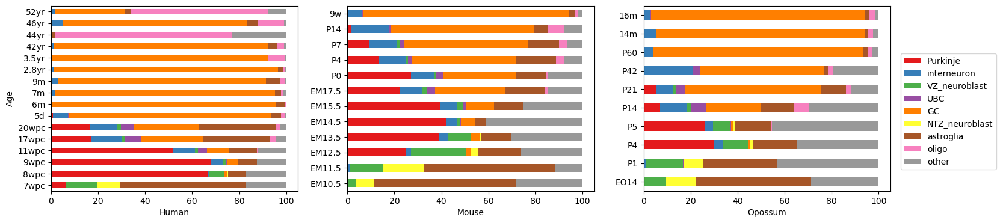

In [12]:
nrows = 1
ncols = 3
wspace = 0.5
figsize = 4
fig, axs = plt.subplots(nrows = nrows, ncols = ncols, 
                        figsize=(ncols * figsize + figsize * wspace * (ncols-1) + (figsize/2), nrows * figsize))
get_proportions(adata_list[1]).plot(kind='barh', stacked=True, ax=axs[0], colormap='Set1', legend=False, ylabel='Age', xlabel='Human', ) 
get_proportions(adata_list[2]).plot(kind='barh', stacked=True, ax=axs[1], colormap='Set1', legend=False, ylabel='', xlabel='Mouse')
get_proportions(adata_list[3]).plot(kind='barh', stacked=True, ax=axs[2], colormap='Set1', legend=False, ylabel='', xlabel='Opossum')
fig.legend(handles=axs[2].containers, loc='center right')
plt.show()

Cell type proportions over time largely track with the patterns we'd expect to see - across all species we see an early domination of Purkinje cells among the main cell types, which falls off as development progresses giving way to granule cells which dominate thereafter. Neuroblasts from both lineages are present in greatest numbers early and dwindle rapidly over development. Astroglial cells, oligodendrocytes, and RL lineage cells show overall fairly low proportions, outside of a few select batches, e.g. human 44yr and 52yr batches. These batches likely reflect sampling errors/biases and can therefore be thrown out as we aren't interested in this time period anyway.

In [13]:
adata_list[1] = adata_list[1][~adata_list[1].obs['age'].isin(['44yr', '52yr'])].copy()

In [14]:
get_age_info(adata_list[1])

,numerical _age,stage_id,batches,total_cells,Purkinje,interneuron,VZ_neuroblast,UBC,GC,NTZ_neuroblast,astroglia,oligo,other
age,,,,,,,,,,,,,
7wpc,-0.594521,Fetal,3,10910,705,7,1420,0,0,1065,5839,0,1874
8wpc,-0.575342,Fetal,9,36668,24452,272,2293,51,464,27,2824,1,6284
9wpc,-0.556164,Fetal,3,11851,8072,611,136,82,503,0,967,0,1480
11wpc,-0.517808,Fetal,3,11556,5978,1104,125,456,1082,26,1350,65,1370
17wpc,-0.402740,Fetal,3,10907,1875,1405,118,772,2877,0,3122,238,500
20wpc,-0.345205,Fetal,1,7469,1219,874,127,424,2061,0,2433,120,211
5d,0.013699,Neonatal,1,3218,29,203,0,15,2759,0,143,46,23
6m,0.500000,Infancy,1,2493,0,11,0,0,2376,0,95,6,5
7m,0.583333,Infancy,1,4712,0,78,0,0,4411,0,122,36,65


Assign stage IDs to mouse and opossum data similar to human data. Stage correspondences come from the Sepp paper Fig 1a. Note that these are somewhat arbitrary and do not denote known boundaries, they are simply to facilitate comparison and help organise the data.

In [15]:
# MOUSE
# Note that these categories are assigned based on correspondence to human brain developmental stage
stages = []
for age in adata_list[2].obs['numerical_age'].values:
    if age >= 63/365: # P63
        stages.append('Adult')
    elif age < 63/365 and age >= 14/365: # Between P14 and P63
        stages.append('Adolescence')
    elif age < 14/365 and age >= 7/365:
        stages.append('Childhood')
    elif age < 7/365 and age >= 4/365:
        stages.append('Infancy')
    elif age < 4/365 and age >= 0:
        stages.append('Neonatal')
    elif age < 0:
        stages.append('Fetal')
    else:
        stages.append('NA')
adata_list[2].obs['stage_id'] = stages

In [16]:
adata_list[2].obs[['Stage', 'age', 'numerical_age', 'stage_id']].drop_duplicates().sort_values(by='numerical_age')

,Stage,age,numerical_age,stage_id
SN102_MOU_E10-5_GCCTCTATCATCTGCC-1,E10.5,EM10.5,-0.026027,Fetal
SN010_MOU_E11-5_GGCAATTTCCTTTCGG-1,E11.5,EM11.5,-0.023288,Fetal
SN126_MOU_E12-5_CGTGAGCAGAATCTCC-1,E12.5,EM12.5,-0.020548,Fetal
SN006_MOU_E13-5_CACATTTCACGCATCG-1,E13.5,EM13.5,-0.017808,Fetal
SN088_MOU_E14-5_TTCTCCTCATTCCTCG-1,E14.5,EM14.5,-0.015068,Fetal
SN016_MOU_E15-5_TAGCCGGCAAATTGCC-1,E15.5,EM15.5,-0.012329,Fetal
SN106_MOU_E17-5_TCTCATATCCGTAGTA-1,E17.5,EM17.5,-0.006849,Fetal
SN127_MOU_P0_TACGGTAGTACTTCTT-1,P0,P0,0.000000,Neonatal
SN038_MOU_P4_AGTGGGATCGTTACAG-1,P4,P4,0.010959,Infancy
SN025_MOU_P7_TCACAAGGTCAATGTC-1,P7,P7,0.019178,Childhood


In [17]:
get_age_info(adata_list[2])

,numerical _age,stage_id,batches,total_cells,Purkinje,interneuron,VZ_neuroblast,UBC,GC,NTZ_neuroblast,astroglia,oligo,other
age,,,,,,,,,,,,,
EM10.5,-0.026027,Fetal,2,1109,0,5,36,0,1,86,668,0,313
EM11.5,-0.023288,Fetal,3,6476,26,32,916,0,1,1146,3596,1,758
EM12.5,-0.020548,Fetal,2,6595,1650,140,1549,0,125,209,1208,0,1714
EM13.5,-0.017808,Fetal,4,15851,6142,675,1504,0,598,59,2064,0,4809
EM14.5,-0.015068,Fetal,2,1892,793,94,17,12,109,0,90,3,774
EM15.5,-0.012329,Fetal,2,6420,2521,466,181,72,765,0,795,6,1614
EM17.5,-0.006849,Fetal,2,6470,1441,620,144,207,1932,0,1097,74,955
P0,0.000000,Neonatal,2,4084,1100,411,26,132,1267,0,507,50,591
P4,0.010959,Infancy,4,1467,198,168,11,27,649,0,250,47,117


In [18]:
# OPOSSUM
# Note that these categories are assigned based on correspondence to human brain developmental stage and that
# opossum brain development happens much later compared to the other species, with the majority of development 
# ocurring postnatally
stages = []
for age in adata_list[3].obs['numerical_age'].values:
    if age >= 1: # 1y
        stages.append('Adult')
    elif age <= 60/365 and age >= 42/365: # Between P42 and P60
        stages.append('Adolescence')
    elif age < 42/365 and age >= 21/365:
        stages.append('Childhood')
    elif age < 21/365 and age >= 14/365:
        stages.append('Infancy')
    elif age < 14/365 and age >= 0:
        stages.append('Neonatal')
    elif age < 0:
        stages.append('Fetal')
    else:
        stages.append('NA')
adata_list[3].obs['stage_id'] = stages

In [19]:
adata_list[3].obs[['Stage', 'age', 'numerical_age', 'stage_id']].drop_duplicates().sort_values(by='numerical_age')

,Stage,age,numerical_age,stage_id
SN174_OPO_E14-25_AGTAACCAGGACAGTC-1,E14.5,EO14,-0.002740,Fetal
SN208_OPO_P1_TGTCCACGTCGCATTA-1,P1,P1,0.002740,Neonatal
SN155_OPO_P4_CGCCAGAAGAAAGCGA-1,P4,P4,0.010959,Neonatal
SN070_OPO_P5_CATTATCAGAGCAATT-1,P5,P5,0.013699,Neonatal
SN152_OPO_P14_TCATTTGTCATTCACT-1,P14,P14,0.038356,Infancy
SN109_OPO_P21_TTAGGACTCTGTCAAG-1,P21,P21,0.057534,Childhood
SN065_OPO_P42_CAACTAGGTTCAGGCC-1,P42,P42,0.115068,Adolescence
SN204_OPO_P60_TCCAGAACATCGCTGG-1,P60,P60,0.164384,Adolescence
SN148_OPO_adult_ATCTTCACAATCTAGC-1,adult,14m,1.166667,Adult
SN147_OPO_adult_ATTCACTCAAGGCGTA-1,adult,16m,1.333333,Adult


In [20]:
get_age_info(adata_list[3])

,numerical _age,stage_id,batches,total_cells,Purkinje,interneuron,VZ_neuroblast,UBC,GC,NTZ_neuroblast,astroglia,oligo,other
age,,,,,,,,,,,,,
EO14,-0.002740,Fetal,2,10349,0,4,995,0,0,1328,5033,0,2989
P1,0.002740,Neonatal,2,11048,17,75,1761,15,0,907,3513,0,4760
P4,0.010959,Neonatal,2,11284,3385,412,1213,16,85,113,2149,10,3901
P5,0.013699,Neonatal,2,5164,1341,184,375,18,56,37,798,7,2348
P14,0.038356,Infancy,3,21148,1468,2417,348,1379,4906,2,2965,1369,6294
P21,0.057534,Childhood,2,7146,364,520,90,299,4124,0,748,147,854
P42,0.115068,Adolescence,2,1659,2,344,0,56,868,0,29,36,324
P60,0.164384,Adolescence,2,10513,18,384,0,15,9391,0,226,171,308
14m,1.166667,Adult,1,3987,10,212,0,0,3525,0,49,93,98


In [21]:
# Save updated anndata objects
adata_list[1].write_h5ad('/group/ll005/cmcphan/sepp_data/sepp_human_normal_reduced.h5ad')
adata_list[2].write_h5ad('/group/ll005/cmcphan/sepp_data/sepp_mouse_normal_reduced.h5ad')
adata_list[3].write_h5ad('/group/ll005/cmcphan/sepp_data/sepp_opossum_normal_reduced.h5ad')

---
### Figures

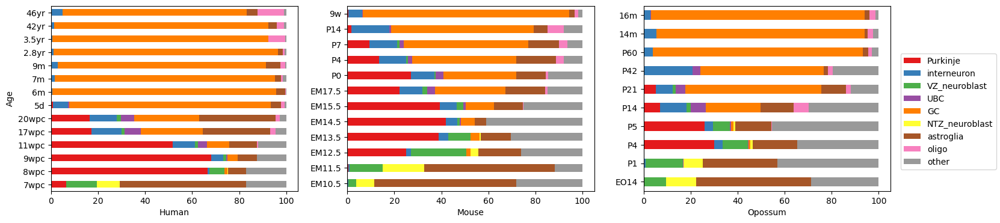

In [39]:
nrows = 1
ncols = 3
wspace = 0.5
figsize = 4
fig, axs = plt.subplots(nrows = nrows, ncols = ncols, 
                        figsize=(ncols * figsize + figsize * wspace * (ncols-1) + (figsize/2), nrows * figsize))
get_proportions(adata_list[1]).plot(kind='barh', stacked=True, ax=axs[0], colormap='Set1', legend=False, ylabel='Age', xlabel='Human', ) 
get_proportions(adata_list[2]).plot(kind='barh', stacked=True, ax=axs[1], colormap='Set1', legend=False, ylabel='', xlabel='Mouse')
get_proportions(adata_list[3]).plot(kind='barh', stacked=True, ax=axs[2], colormap='Set1', legend=False, ylabel='', xlabel='Opossum')
fig.legend(handles=axs[2].containers, loc='center right')
fig.savefig(str(FIG_PATH+'sepp_cell_type_proportions.svg'), dpi=300, bbox_inches='tight')
plt.show()

In [40]:
# Add all major cell types with their marker genes into a dictionary for checking
# Note that for mouse and opossum genes, only the first letter of the symbol is capitalized
markers_gene_symbol = {'Purkinje':['Calb1', 'Skor2'], # Gene symbols
                       'interneuron':['Pax2'],
                       'VZ_neuroblast':['Lhx1', 'Lhx5'], # General VZ progenitor markers
                       'UBC':['Eomes'],
                       'GC':['Gabra6', 'Reln', 'Rbfox3'],
                       'NTZ_neuroblast':['Atoh1'], # General RL progenitor markers
                       'astroglia':['Aqp4', 'Slc1a3'],
                       'oligo':['Mobp', 'Pdgfra']}

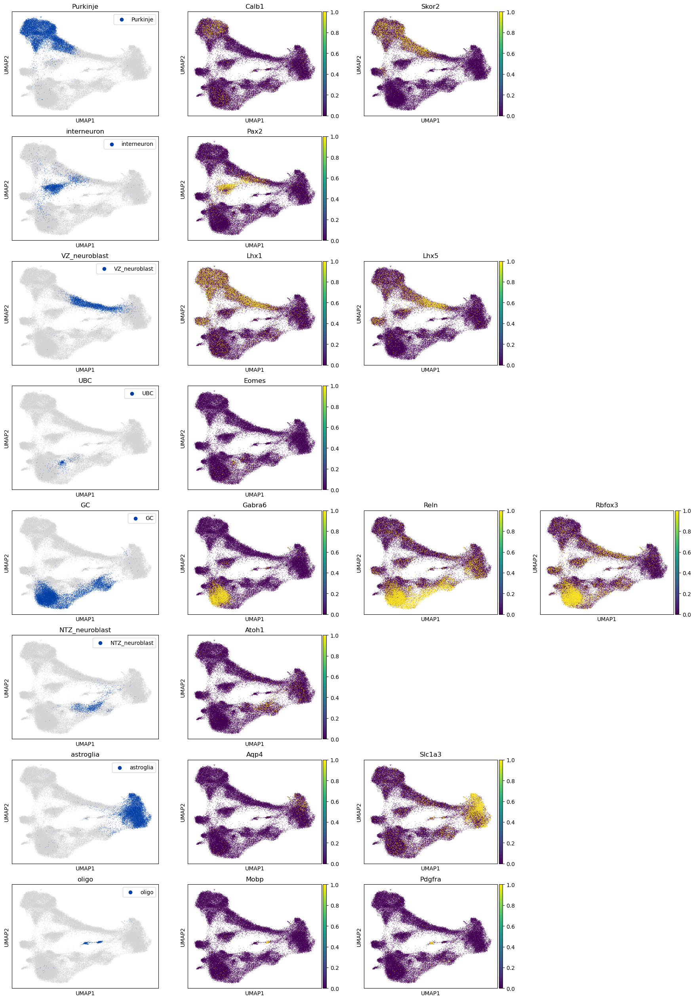

In [41]:
# MOUSE
adata = adata_list[2]
# Dictionary of cell types which will hold each related set of marker genes
# in a nested dictionary, so that we have gene symbols linked to var_names
markers = {}
# UMAP function can only take var_names as input for colour, not gene_symbols, so need to convert
for cell_type in markers_gene_symbol.keys():
    markers[cell_type] = {}
    for marker in markers_gene_symbol[cell_type]:
        name = adata.var_names[adata.var['gene_symbol'] == marker].values
        if name.size>0: # If the marker isn't present in the dataset, ignore it
            markers[cell_type][name[0]] = marker

nrows = 0 
# Calculate how many rows we will need
for cell_type in markers:
    nrows += math.ceil((len(markers[cell_type])+1)/4)
ncols = 4
wspace = 0.5
figsize = 4
fig, axs = plt.subplots(nrows = nrows, ncols = ncols, 
                        figsize=(ncols * figsize + figsize * wspace * (ncols-1), nrows * figsize))
ax_idx_row = 0
for cell_type in markers.keys():
    # First plot in block is just the cell type
    sc.pl.umap(adata, layer='binarized_cts', color='cell_type', gene_symbols='gene_symbol', groups=cell_type,
               na_in_legend=False, legend_loc='upper right', ax=axs[ax_idx_row,0], palette=['#023fa5'], title=cell_type, show=False)
    # Build remaining plots based on relevant marker genes
    ax_idx_col = 1
    for marker in markers[cell_type].keys():
        sc.pl.umap(adata, layer='binarized_cts', color=marker, gene_symbols='gene_symbol',
                   na_in_legend=False, legend_loc='upper right', ax=axs[ax_idx_row, ax_idx_col], 
                   title=markers[cell_type][marker], show=False)
        ax_idx_col+=1
        if ax_idx_col == ncols: # Wrap to next row
            ax_idx_col=0
            ax_idx_row+=1
    while ax_idx_col < ncols and ax_idx_col > 0: # Once markers are exhausted, remove unused plots in row
        axs[ax_idx_row, ax_idx_col].remove()
        ax_idx_col+=1
        if ax_idx_col == ncols:
            ax_idx_row+=1 # Move to next row for the next cell type

In [42]:
fig.savefig(str(FIG_PATH+'sepp_mouse_marker_genes.png'), dpi=300, bbox_inches='tight')

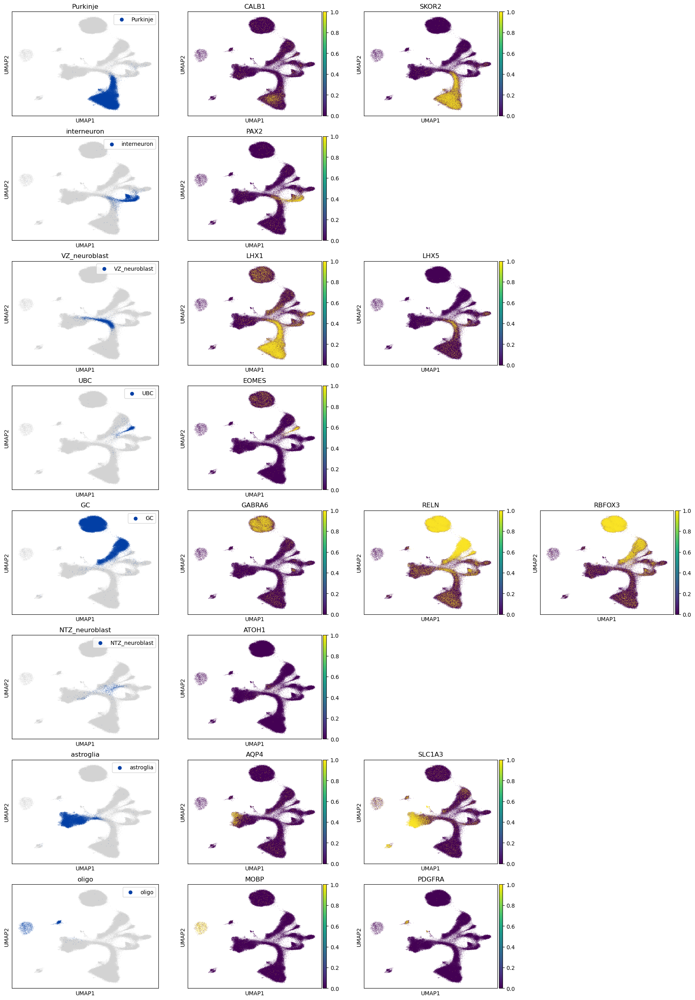

In [43]:
# HUMAN
adata = adata_list[1]
# Dictionary of cell types which will hold each related set of marker genes
# in a nested dictionary, so that we have gene symbols linked to var_names
markers = {}
# UMAP function can only take var_names as input for colour, not gene_symbols, so need to convert
for cell_type in markers_gene_symbol.keys():
    markers[cell_type] = {}
    for marker in markers_gene_symbol[cell_type]:
        marker = marker.upper() # Human gene symbols need to be fully capitalized
        name = adata.var_names[adata.var['gene_symbol'] == marker].values
        if name.size>0: # If the marker isn't present in the dataset, ignore it
            markers[cell_type][name[0]] = marker

nrows = 0 
# Calculate how many rows we will need
for cell_type in markers:
    nrows += math.ceil((len(markers[cell_type])+1)/4)
ncols = 4
wspace = 0.5
figsize = 4
fig, axs = plt.subplots(nrows = nrows, ncols = ncols, 
                        figsize=(ncols * figsize + figsize * wspace * (ncols-1), nrows * figsize))
ax_idx_row = 0
for cell_type in markers.keys():
    # First plot in block is just the cell type
    sc.pl.umap(adata, layer='binarized_cts', color='cell_type', gene_symbols='gene_symbol', groups=cell_type,
               na_in_legend=False, legend_loc='upper right', ax=axs[ax_idx_row,0], palette=['#023fa5'], title=cell_type, show=False)
    # Build remaining plots based on relevant marker genes
    ax_idx_col = 1
    for marker in markers[cell_type].keys():
        sc.pl.umap(adata, layer='binarized_cts', color=marker, gene_symbols='gene_symbol',
                   na_in_legend=False, legend_loc='upper right', ax=axs[ax_idx_row, ax_idx_col], 
                   title=markers[cell_type][marker], show=False)
        ax_idx_col+=1
        if ax_idx_col == ncols: # Wrap to next row
            ax_idx_col=0
            ax_idx_row+=1
    while ax_idx_col < ncols and ax_idx_col > 0: # Once markers are exhausted, remove unused plots in row
        axs[ax_idx_row, ax_idx_col].remove()
        ax_idx_col+=1
        if ax_idx_col == ncols:
            ax_idx_row+=1 # Move to next row for the next cell type

In [44]:
fig.savefig(str(FIG_PATH+'sepp_human_marker_genes.png'), dpi=300, bbox_inches='tight')

In [45]:
# Add all major cell types with their marker genes into a dictionary for checking
# Note that for mouse and opossum genes, only the first letter of the symbol is capitalized
markers_gene_symbol = {'Purkinje':['Calb1', 'Skor2'], # Gene symbols
                       'interneuron':['Pax2'],
                       'VZ_neuroblast':['Lhx1', 'Lhx5'], # General VZ progenitor markers
                       'UBC':['Eomes', 'Lmx1a'],
                       'GC':['Gabra6', 'Reln', 'Rbfox3'],
                       'NTZ_neuroblast':['Atoh1'], # General RL progenitor markers
                       'astroglia':['Aqp4', 'Slc1a3'],
                       'oligo':['Mog', 'Pdgfra']}

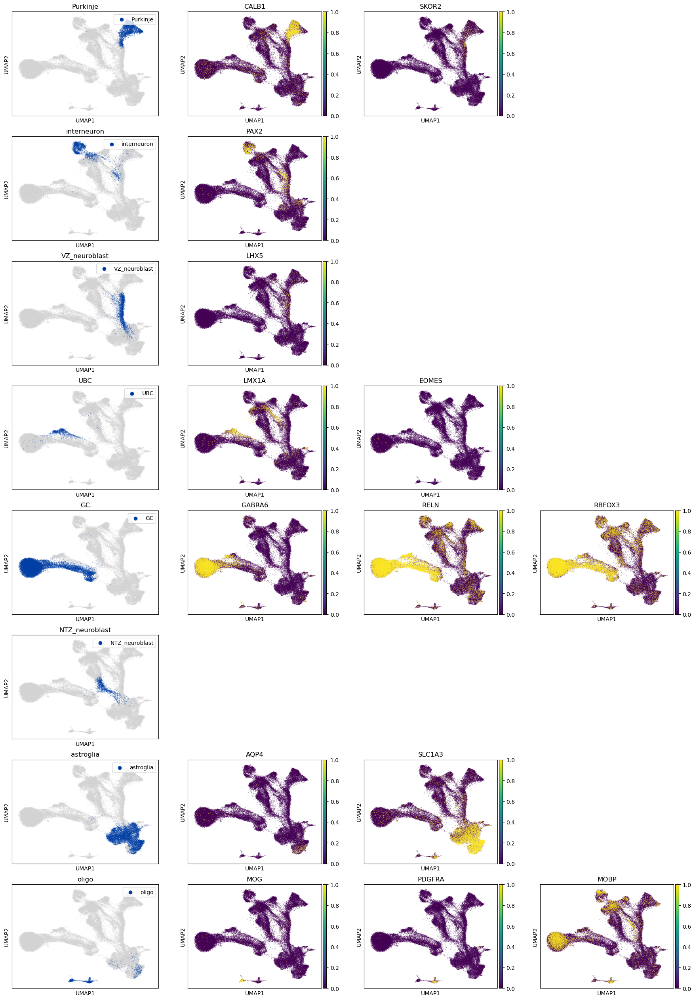

In [46]:
# OPOSSUM
adata = adata_list[3]
# Dictionary of cell types which will hold each related set of marker genes
# in a nested dictionary, so that we have gene symbols linked to var_names
markers = {}
# UMAP function can only take var_names as input for colour, not gene_symbols, so need to convert
for cell_type in markers_gene_symbol.keys():
    markers[cell_type] = {}
    for marker in markers_gene_symbol[cell_type]:
        marker = marker.upper() # Opossum gene symbols are borrowed from humans, need to be fully capitalized
        name = adata.var_names[adata.var['gene_symbol'] == marker].values
        if name.size>0: # If the marker isn't present in the dataset, ignore it
            markers[cell_type][name[0]] = marker
# Some major markers are missing from the Opossum data, manually checked for orthologues via Ensembl and added in if present (see above)
markers['UBC']['ENSMODG00000015057']='EOMES'
markers['oligo']['ENSMODG00000011047']='MOBP'
markers['VZ_neuroblast']['ENSMODG00000027538']='LHX5'

nrows = 0 
# Calculate how many rows we will need
for cell_type in markers:
    nrows += math.ceil((len(markers[cell_type])+1)/4)
ncols = 4
wspace = 0.5
figsize = 4
fig, axs = plt.subplots(nrows = nrows, ncols = ncols, 
                        figsize=(ncols * figsize + figsize * wspace * (ncols-1), nrows * figsize))
ax_idx_row = 0
for cell_type in markers.keys():
    # First plot in block is just the cell type
    sc.pl.umap(adata, layer='binarized_cts', color='cell_type', gene_symbols='gene_symbol', groups=cell_type,
               na_in_legend=False, legend_loc='upper right', ax=axs[ax_idx_row,0], palette=['#023fa5'], title=cell_type, show=False)
    # Build remaining plots based on relevant marker genes
    ax_idx_col = 1
    for marker in markers[cell_type].keys():
        sc.pl.umap(adata, layer='binarized_cts', color=marker, gene_symbols='gene_symbol',
                   na_in_legend=False, legend_loc='upper right', ax=axs[ax_idx_row, ax_idx_col], 
                   title=markers[cell_type][marker], show=False)
        ax_idx_col+=1
        if ax_idx_col == ncols: # Wrap to next row
            ax_idx_col=0
            ax_idx_row+=1
    while ax_idx_col < ncols and ax_idx_col > 0: # Once markers are exhausted, remove unused plots in row
        axs[ax_idx_row, ax_idx_col].remove()
        ax_idx_col+=1
        if ax_idx_col == ncols:
            ax_idx_row+=1 # Move to next row for the next cell type

In [47]:
fig.savefig(str(FIG_PATH+'sepp_opossum_marker_genes.png'), dpi=300, bbox_inches='tight')

#### Harmonised UMAPs

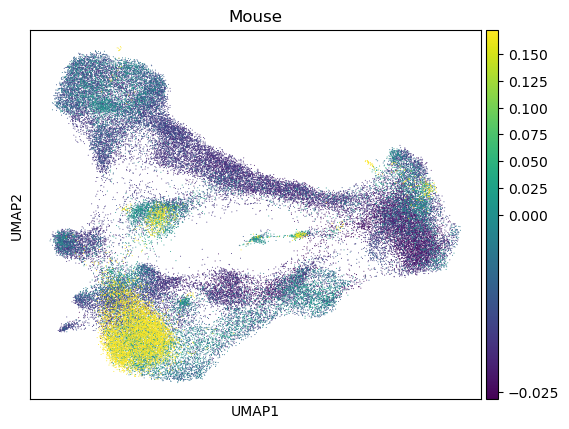

In [48]:
# MOUSE
g = sc.pl.umap(adata_list[2], layer='binarized_cts', color='numerical_age', vcenter=0, title='Mouse', return_fig=True)
g.savefig(str(FIG_PATH+'sepp_mouse_harmonised_umap.png'), dpi=300, bbox_inches='tight')

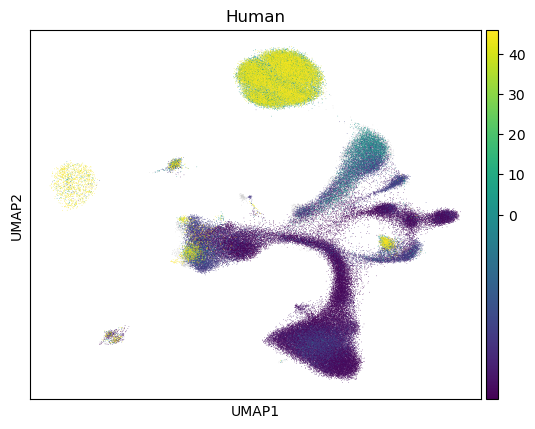

In [49]:
# HUMAN
# Map of developmental age, for comparison
g = sc.pl.umap(adata_list[1], layer='binarized_cts', color='numerical_age', vcenter=0, title='Human', return_fig=True)
g.savefig(str(FIG_PATH+'sepp_human_harmonised_umap.png'), dpi=300, bbox_inches='tight')

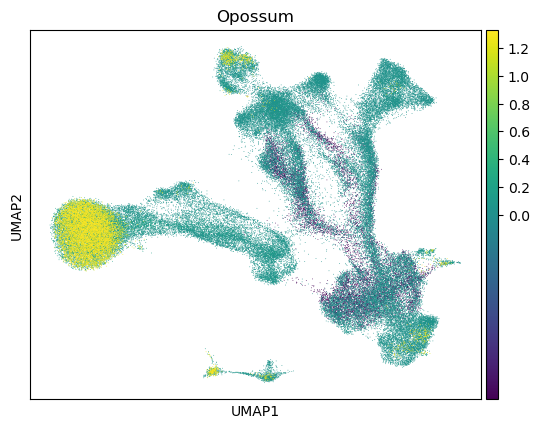

In [50]:
# OPOSSUM
# Map of developmental age, for comparison
g = sc.pl.umap(adata_list[3], layer='binarized_cts', color='numerical_age', vcenter=0, title='Opossum', return_fig=True)
g.savefig(str(FIG_PATH+'sepp_opossum_harmonised_umap.png'), dpi=300, bbox_inches='tight')